# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [65]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

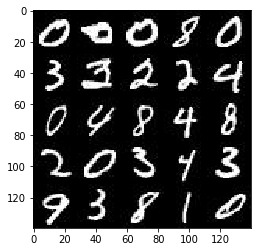

In [66]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

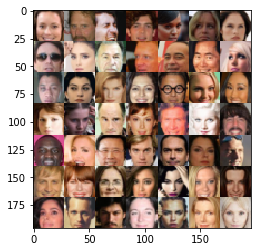

In [67]:
show_n_images = 50

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [68]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0-rc2
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [69]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    real_input_image = tf.placeholder(
        tf.float32, 
        shape=(None, image_width, image_height, image_channels), 
        name = 'real_input_image')
    
    z_input = tf.placeholder(tf.float32, shape=(None, z_dim), name='z_input')
    learning_rate = tf.placeholder(tf.float32, shape=(), name='learning_rate')
    return real_input_image, z_input, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [70]:
def discriminator(images, reuse=False, alpha=0.2, dropout_rate=0.):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse):
        images = tf.layers.dropout(images, rate=dropout_rate)
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        relu3 = tf.layers.dropout(relu3, rate=dropout_rate)

        x4 = tf.layers.conv2d(relu3, 512, 5, strides=2, padding='same')
        bn4 = tf.layers.batch_normalization(x4, training=True)
        relu4 = tf.maximum(alpha * bn4, bn4)
        
        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
    return out, logits
    


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [71]:
def generator(z, out_channel_dim, is_train=True, alpha=0.02):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    with tf.variable_scope('generator', reuse=not is_train):
        # First fully connected layer
        x1 = tf.layers.dense(z, 7*7*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=1, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha * x3, x3)        
        
        x4 = tf.layers.conv2d_transpose(x3, 64, 5, strides=1, padding='same')
        x4 = tf.layers.batch_normalization(x4, training=is_train)
        x4 = tf.maximum(alpha * x4, x4)
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x4, out_channel_dim, 5, strides=2, padding='same')
    
        out = tf.tanh(logits)
        
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [72]:
def model_loss(input_real, input_z, out_channel_dim, dropout_rate=0.):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real, dropout_rate = dropout_rate)
    d_model_fake, d_logits_fake = discriminator(g_model, dropout_rate = dropout_rate, reuse=True)
    print(input_real.shape)
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(
            logits=d_logits_real, 
            labels=
#             tf.random_uniform(
#                 (input_real.shape[0],1),
#                 minval=0.7,
#                 maxval=1.2,
#                 dtype=tf.float32)))
            tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(
            logits=d_logits_fake, 
            labels=
#             tf.random_uniform(
#                 (input_z.shape[0],1),
#                 minval=0.,
#                 maxval=0.3,
#                 dtype=tf.float32)))
            tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(
            logits=d_logits_fake, 
            labels=
#             tf.random_uniform(
#                 (input_z.shape[0],1),
#                 minval=0.,
#                 maxval=0.3,
#                 dtype=tf.float32)))
            tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

(?, 28, 28, 4)
Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [73]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
        # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt
    


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [74]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [75]:


def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode, dropout_rate):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    print(data_image_mode)
    print(data_shape)
    print(learning_rate)
    print(z_dim)
    #tf.reset_default_graph()
        
    # Build the network here
    real_input_image, z_input, learning_rate_holder = model_inputs(
        data_shape[1], 
        data_shape[2], 
        data_shape[3], 
        z_dim)
    d_loss, g_loss = model_loss(real_input_image, z_input, data_shape[3])
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
        
    saver = tf.train.Saver()
    
    sample_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
    
    samples, losses = [], []
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        nd_batches = int(data_shape[0] / batch_size)
        
        for epoch_i in range(epoch_count):
            batch = 0
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                batch +=1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                # Run optimizers
                _ = sess.run(d_opt, feed_dict={
                    real_input_image: batch_images, 
                    z_input: batch_z,
                    learning_rate_holder: learning_rate})
                _ = sess.run(g_opt, feed_dict={
                    z_input: batch_z, 
                    real_input_image: batch_images, 
                    learning_rate_holder: learning_rate})
                if batch % 50 == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({z_input: batch_z, real_input_image: batch_images})
                    train_loss_g = g_loss.eval({z_input: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                          "batch {}/{}...".format(batch, nd_batches),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))
                    show_generator_output(sess, 50, z_input, data_shape[3], data_image_mode)

        batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
        train_loss_g = g_loss.eval({z_input: batch_z})

        print("FINAL RESULT",
              "Generator Loss: {:.4f}".format(train_loss_g))
        
        show_generator_output(sess, 50, z_input, data_shape[3], data_image_mode)
    return        

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

L
(60000, 28, 28, 1)
0.0005
128
(?, 28, 28, 1)
Epoch 1/2... batch 50/1875... Discriminator Loss: 2.2684... Generator Loss: 6.2259


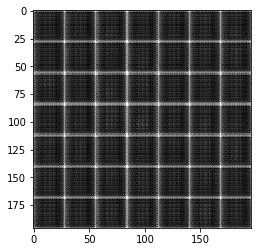

Epoch 1/2... batch 100/1875... Discriminator Loss: 0.9114... Generator Loss: 0.7490


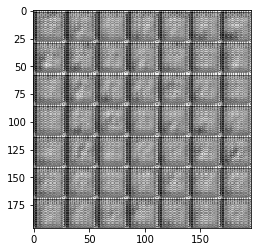

Epoch 1/2... batch 150/1875... Discriminator Loss: 1.1468... Generator Loss: 1.3081


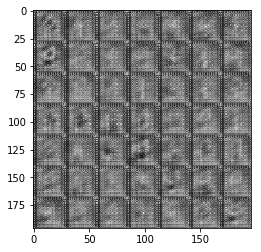

Epoch 1/2... batch 200/1875... Discriminator Loss: 1.6383... Generator Loss: 0.3387


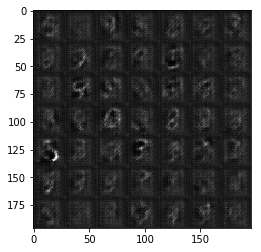

Epoch 1/2... batch 250/1875... Discriminator Loss: 1.2719... Generator Loss: 0.5212


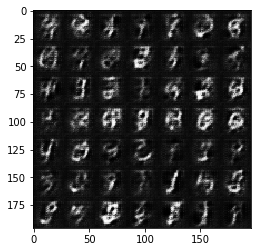

Epoch 1/2... batch 300/1875... Discriminator Loss: 1.3513... Generator Loss: 0.4758


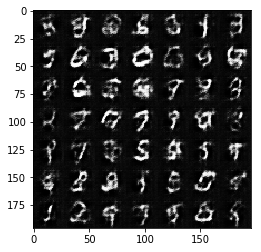

Epoch 1/2... batch 350/1875... Discriminator Loss: 1.5388... Generator Loss: 0.6819


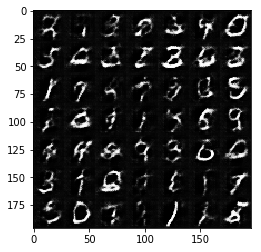

Epoch 1/2... batch 400/1875... Discriminator Loss: 1.2311... Generator Loss: 0.6113


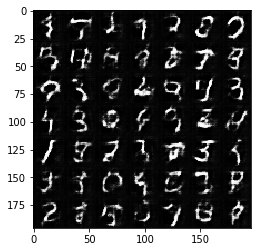

Epoch 1/2... batch 450/1875... Discriminator Loss: 1.6144... Generator Loss: 0.2907


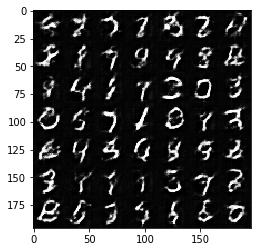

Epoch 1/2... batch 500/1875... Discriminator Loss: 1.4787... Generator Loss: 0.8521


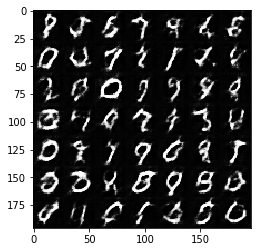

Epoch 1/2... batch 550/1875... Discriminator Loss: 1.2659... Generator Loss: 1.2922


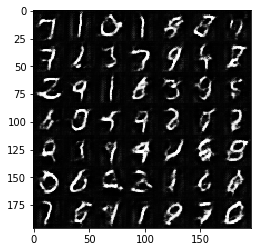

Epoch 1/2... batch 600/1875... Discriminator Loss: 1.1394... Generator Loss: 0.8426


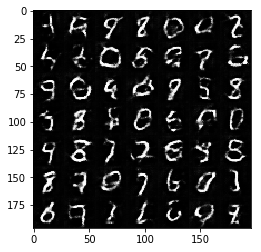

Epoch 1/2... batch 650/1875... Discriminator Loss: 1.3955... Generator Loss: 0.5727


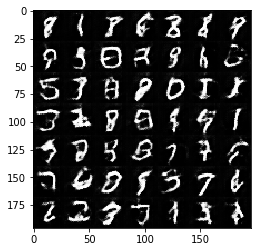

Epoch 1/2... batch 700/1875... Discriminator Loss: 1.2256... Generator Loss: 0.5815


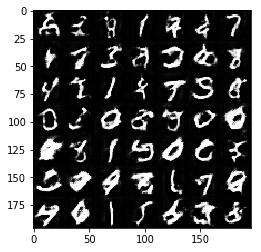

Epoch 1/2... batch 750/1875... Discriminator Loss: 1.5788... Generator Loss: 0.3959


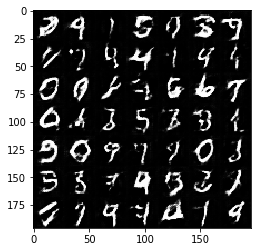

Epoch 1/2... batch 800/1875... Discriminator Loss: 1.3733... Generator Loss: 0.5022


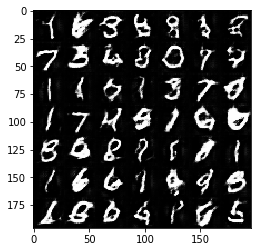

Epoch 1/2... batch 850/1875... Discriminator Loss: 1.3874... Generator Loss: 0.4651


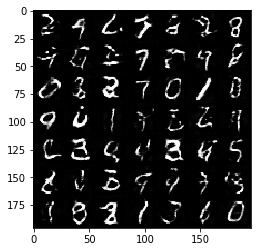

Epoch 1/2... batch 900/1875... Discriminator Loss: 1.3069... Generator Loss: 1.0071


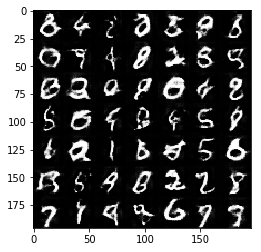

Epoch 1/2... batch 950/1875... Discriminator Loss: 1.3093... Generator Loss: 0.8720


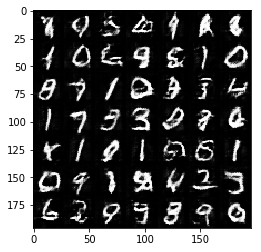

Epoch 1/2... batch 1000/1875... Discriminator Loss: 1.3777... Generator Loss: 0.5337


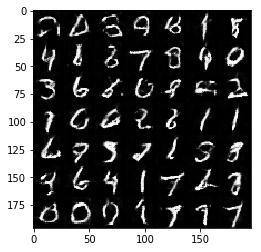

Epoch 1/2... batch 1050/1875... Discriminator Loss: 1.1093... Generator Loss: 0.5880


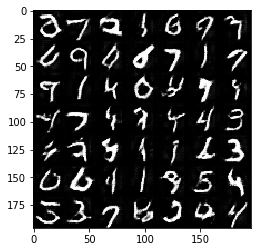

Epoch 1/2... batch 1100/1875... Discriminator Loss: 1.4434... Generator Loss: 0.4353


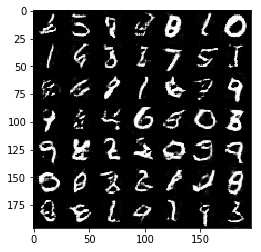

Epoch 1/2... batch 1150/1875... Discriminator Loss: 1.2787... Generator Loss: 0.4759


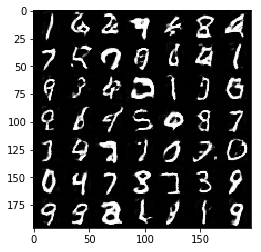

Epoch 1/2... batch 1200/1875... Discriminator Loss: 1.3391... Generator Loss: 0.4682


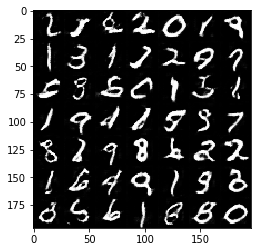

Epoch 1/2... batch 1250/1875... Discriminator Loss: 1.2986... Generator Loss: 0.5803


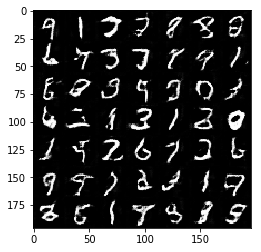

Epoch 1/2... batch 1300/1875... Discriminator Loss: 1.1828... Generator Loss: 0.6604


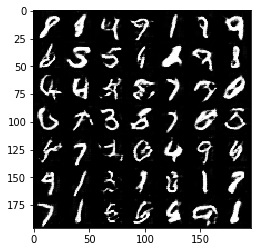

Epoch 1/2... batch 1350/1875... Discriminator Loss: 1.4612... Generator Loss: 0.3942


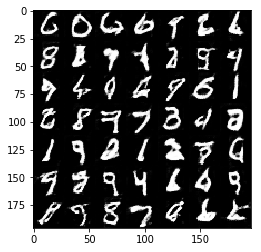

Epoch 1/2... batch 1400/1875... Discriminator Loss: 1.0121... Generator Loss: 0.7567


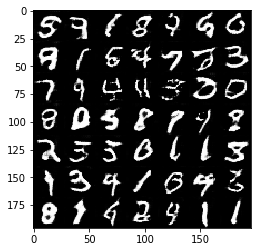

Epoch 1/2... batch 1450/1875... Discriminator Loss: 1.1324... Generator Loss: 1.5394


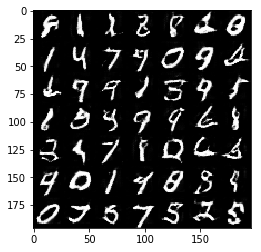

Epoch 1/2... batch 1500/1875... Discriminator Loss: 1.6623... Generator Loss: 0.2919


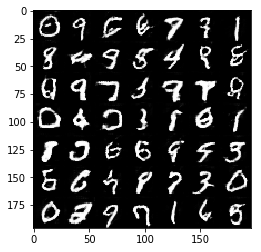

Epoch 1/2... batch 1550/1875... Discriminator Loss: 1.0906... Generator Loss: 0.8583


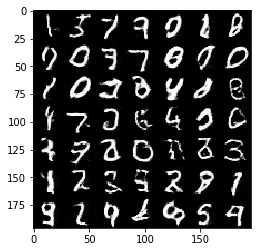

Epoch 1/2... batch 1600/1875... Discriminator Loss: 0.8986... Generator Loss: 1.1428


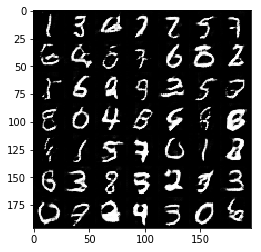

Epoch 1/2... batch 1650/1875... Discriminator Loss: 1.0489... Generator Loss: 0.8914


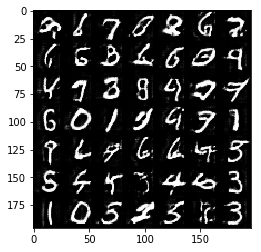

Epoch 1/2... batch 1700/1875... Discriminator Loss: 1.6360... Generator Loss: 0.3372


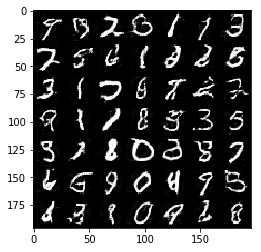

Epoch 1/2... batch 1750/1875... Discriminator Loss: 1.3179... Generator Loss: 0.5108


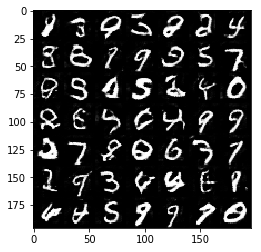

Epoch 1/2... batch 1800/1875... Discriminator Loss: 1.5952... Generator Loss: 0.3077


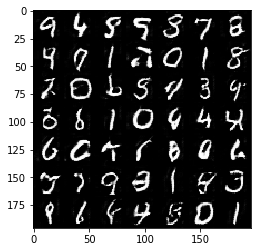

Epoch 1/2... batch 1850/1875... Discriminator Loss: 1.1465... Generator Loss: 0.6607


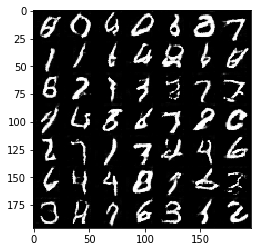

Epoch 2/2... batch 50/1875... Discriminator Loss: 1.1627... Generator Loss: 0.7583


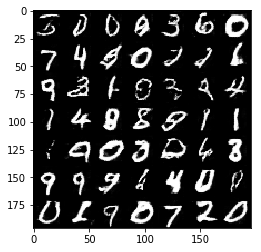

Epoch 2/2... batch 100/1875... Discriminator Loss: 1.7503... Generator Loss: 0.2601


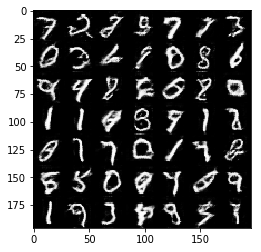

Epoch 2/2... batch 150/1875... Discriminator Loss: 1.1971... Generator Loss: 0.5151


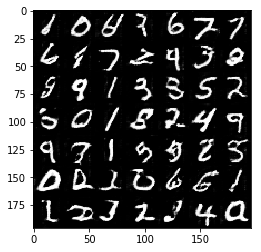

Epoch 2/2... batch 200/1875... Discriminator Loss: 1.2631... Generator Loss: 0.5119


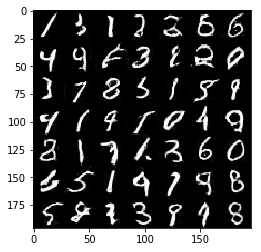

Epoch 2/2... batch 250/1875... Discriminator Loss: 1.4030... Generator Loss: 0.5472


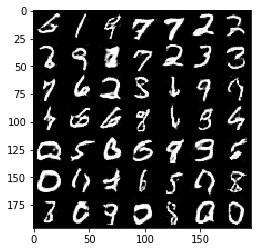

Epoch 2/2... batch 300/1875... Discriminator Loss: 1.6929... Generator Loss: 0.2639


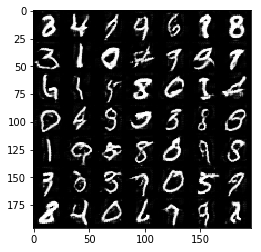

Epoch 2/2... batch 350/1875... Discriminator Loss: 1.4261... Generator Loss: 0.4424


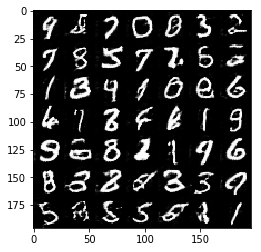

Epoch 2/2... batch 400/1875... Discriminator Loss: 0.9543... Generator Loss: 0.8428


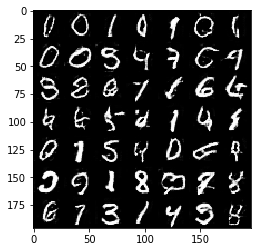

Epoch 2/2... batch 450/1875... Discriminator Loss: 1.2256... Generator Loss: 0.5295


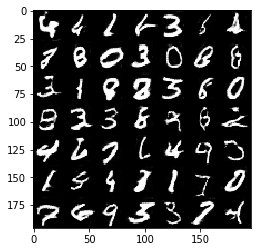

Epoch 2/2... batch 500/1875... Discriminator Loss: 0.9554... Generator Loss: 0.9329


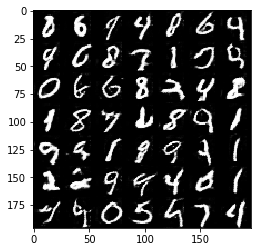

Epoch 2/2... batch 550/1875... Discriminator Loss: 1.2628... Generator Loss: 0.7081


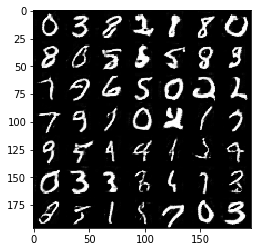

Epoch 2/2... batch 600/1875... Discriminator Loss: 1.0830... Generator Loss: 0.7587


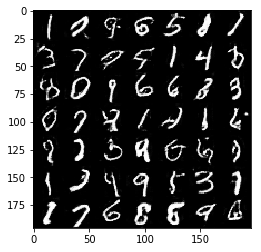

Epoch 2/2... batch 650/1875... Discriminator Loss: 1.0947... Generator Loss: 0.8210


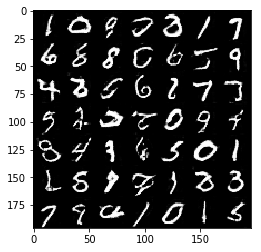

Epoch 2/2... batch 700/1875... Discriminator Loss: 1.2437... Generator Loss: 0.5573


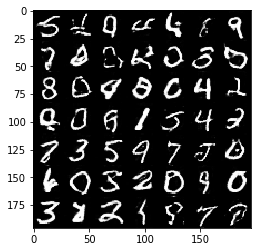

Epoch 2/2... batch 750/1875... Discriminator Loss: 1.4077... Generator Loss: 0.5253


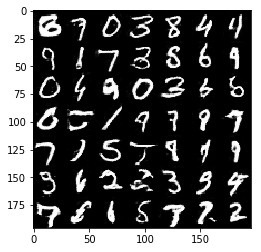

Epoch 2/2... batch 800/1875... Discriminator Loss: 1.3699... Generator Loss: 0.4137


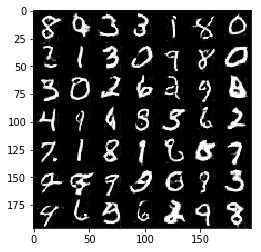

Epoch 2/2... batch 850/1875... Discriminator Loss: 1.2154... Generator Loss: 1.4620


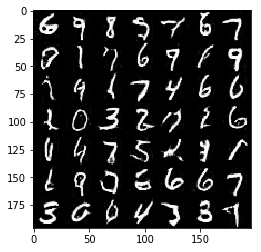

Epoch 2/2... batch 900/1875... Discriminator Loss: 1.6019... Generator Loss: 0.2915


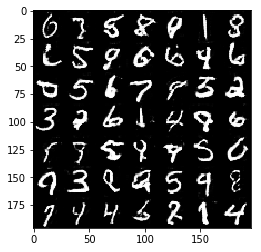

Epoch 2/2... batch 950/1875... Discriminator Loss: 1.3335... Generator Loss: 0.4903


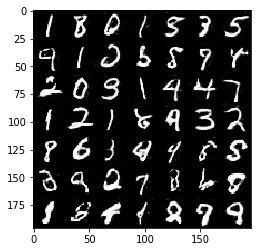

Epoch 2/2... batch 1000/1875... Discriminator Loss: 1.1656... Generator Loss: 0.9090


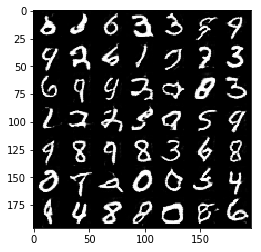

Epoch 2/2... batch 1050/1875... Discriminator Loss: 1.1972... Generator Loss: 0.6049


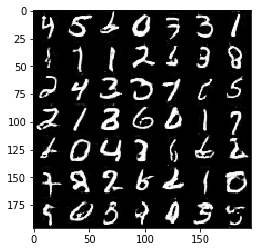

Epoch 2/2... batch 1100/1875... Discriminator Loss: 1.0863... Generator Loss: 1.5185


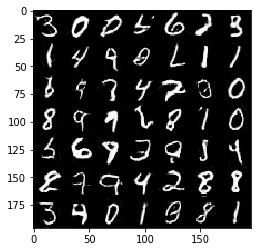

Epoch 2/2... batch 1150/1875... Discriminator Loss: 1.1620... Generator Loss: 0.6166


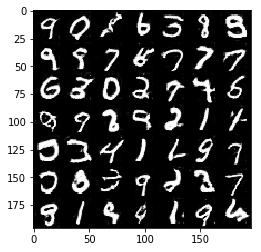

Epoch 2/2... batch 1200/1875... Discriminator Loss: 1.2838... Generator Loss: 0.8016


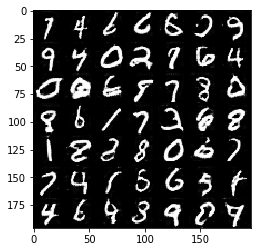

Epoch 2/2... batch 1250/1875... Discriminator Loss: 1.1891... Generator Loss: 0.7376


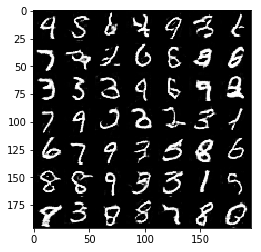

Epoch 2/2... batch 1300/1875... Discriminator Loss: 1.1003... Generator Loss: 0.5865


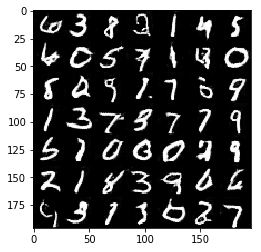

Epoch 2/2... batch 1350/1875... Discriminator Loss: 1.3705... Generator Loss: 0.4630


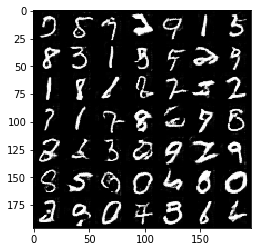

Epoch 2/2... batch 1400/1875... Discriminator Loss: 1.1159... Generator Loss: 0.5454


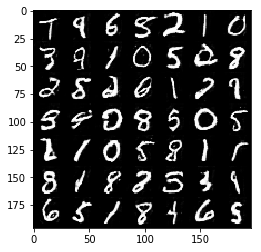

Epoch 2/2... batch 1450/1875... Discriminator Loss: 1.4548... Generator Loss: 0.8880


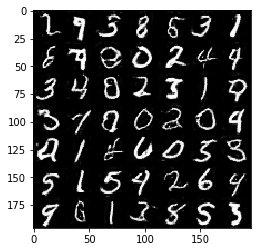

Epoch 2/2... batch 1500/1875... Discriminator Loss: 1.0662... Generator Loss: 0.9665


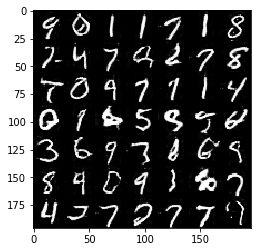

Epoch 2/2... batch 1550/1875... Discriminator Loss: 1.1240... Generator Loss: 1.1518


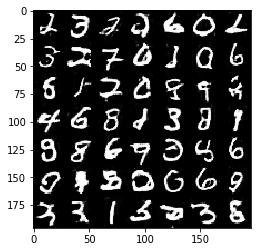

Epoch 2/2... batch 1600/1875... Discriminator Loss: 1.1135... Generator Loss: 0.6119


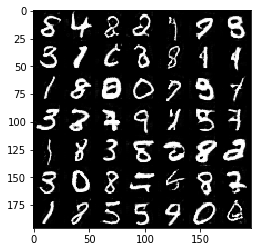

Epoch 2/2... batch 1650/1875... Discriminator Loss: 1.2159... Generator Loss: 0.5841


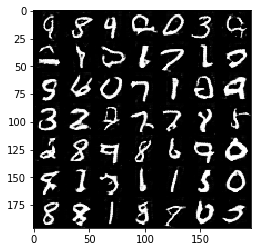

Epoch 2/2... batch 1700/1875... Discriminator Loss: 1.3411... Generator Loss: 0.4441


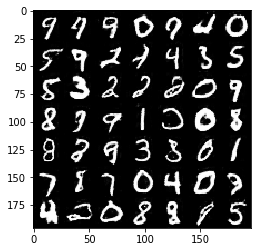

Epoch 2/2... batch 1750/1875... Discriminator Loss: 1.4928... Generator Loss: 0.3855


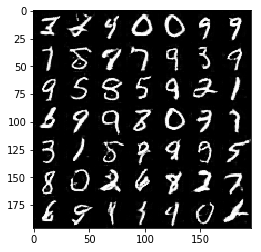

Epoch 2/2... batch 1800/1875... Discriminator Loss: 2.0327... Generator Loss: 2.3480


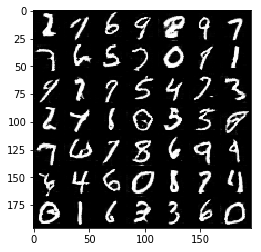

Epoch 2/2... batch 1850/1875... Discriminator Loss: 1.1832... Generator Loss: 0.8830


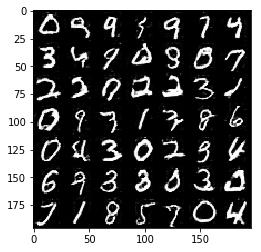

FINAL RESULT Generator Loss: 1.3892


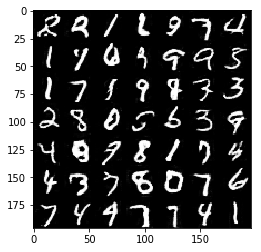

In [62]:
batch_size = 32
z_dim = 128
learning_rate = 0.0005
beta1 = 0.5
dropout_rate = 0.2

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode, dropout_rate)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

RGB
(202599, 28, 28, 3)
0.0002
128
(?, 28, 28, 3)
Epoch 1/1... batch 50/6331... Discriminator Loss: 1.6307... Generator Loss: 0.3252


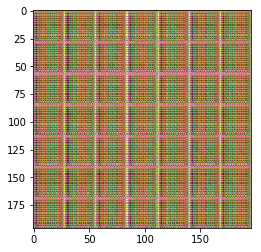

Epoch 1/1... batch 100/6331... Discriminator Loss: 1.4580... Generator Loss: 0.4370


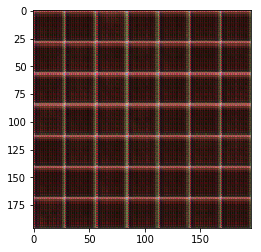

Epoch 1/1... batch 150/6331... Discriminator Loss: 0.8259... Generator Loss: 1.5436


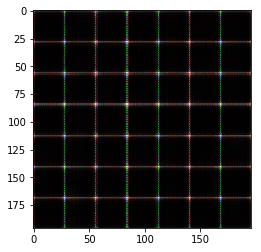

Epoch 1/1... batch 200/6331... Discriminator Loss: 0.9377... Generator Loss: 1.2788


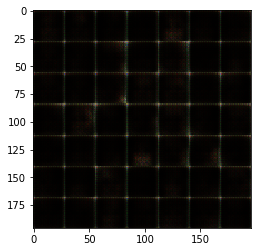

Epoch 1/1... batch 250/6331... Discriminator Loss: 0.7807... Generator Loss: 1.0374


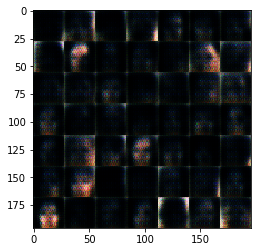

Epoch 1/1... batch 300/6331... Discriminator Loss: 1.0700... Generator Loss: 0.8836


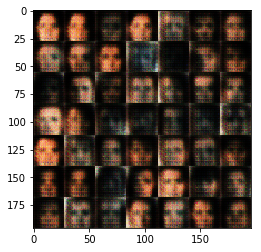

Epoch 1/1... batch 350/6331... Discriminator Loss: 1.5649... Generator Loss: 0.3551


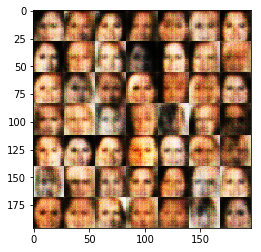

Epoch 1/1... batch 400/6331... Discriminator Loss: 1.7176... Generator Loss: 0.3237


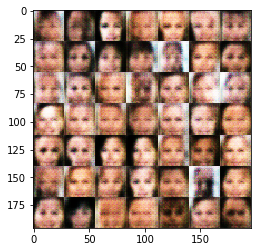

Epoch 1/1... batch 450/6331... Discriminator Loss: 1.2564... Generator Loss: 0.8478


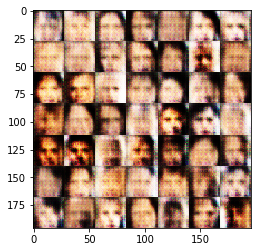

Epoch 1/1... batch 500/6331... Discriminator Loss: 1.4086... Generator Loss: 0.6808


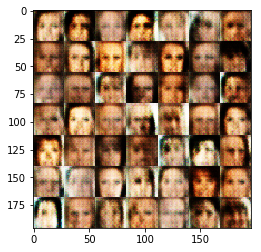

Epoch 1/1... batch 550/6331... Discriminator Loss: 1.4839... Generator Loss: 0.4721


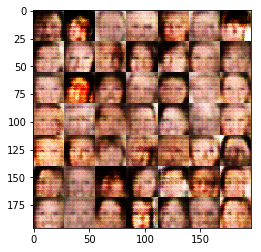

Epoch 1/1... batch 600/6331... Discriminator Loss: 1.4626... Generator Loss: 0.7016


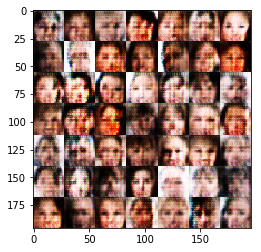

Epoch 1/1... batch 650/6331... Discriminator Loss: 1.4667... Generator Loss: 0.6082


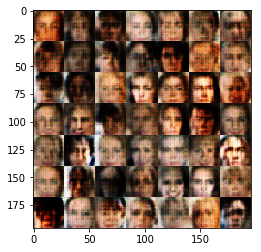

Epoch 1/1... batch 700/6331... Discriminator Loss: 1.7511... Generator Loss: 0.6674


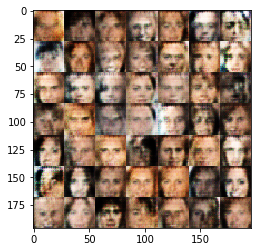

Epoch 1/1... batch 750/6331... Discriminator Loss: 1.3310... Generator Loss: 1.1911


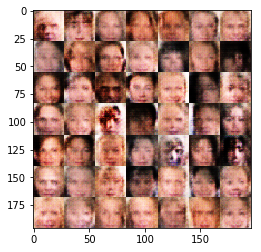

Epoch 1/1... batch 800/6331... Discriminator Loss: 1.3070... Generator Loss: 0.6238


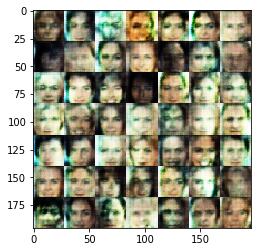

Epoch 1/1... batch 850/6331... Discriminator Loss: 1.2123... Generator Loss: 0.9248


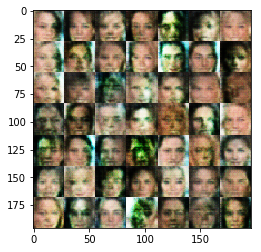

Epoch 1/1... batch 900/6331... Discriminator Loss: 1.4493... Generator Loss: 0.4663


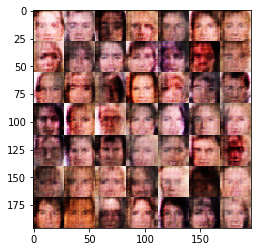

Epoch 1/1... batch 950/6331... Discriminator Loss: 1.5528... Generator Loss: 0.6774


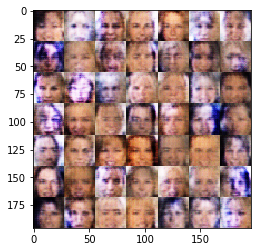

Epoch 1/1... batch 1000/6331... Discriminator Loss: 1.1639... Generator Loss: 0.8643


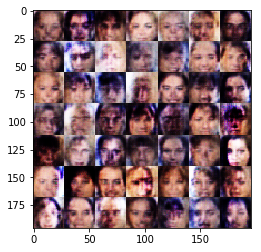

Epoch 1/1... batch 1050/6331... Discriminator Loss: 1.3855... Generator Loss: 0.5505


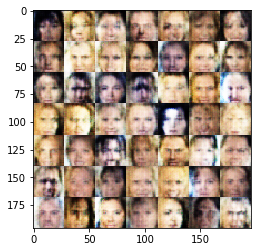

Epoch 1/1... batch 1100/6331... Discriminator Loss: 1.3220... Generator Loss: 0.5288


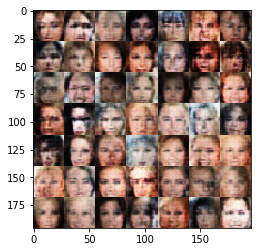

Epoch 1/1... batch 1150/6331... Discriminator Loss: 1.2389... Generator Loss: 0.6470


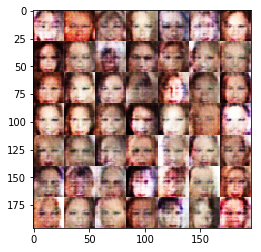

Epoch 1/1... batch 1200/6331... Discriminator Loss: 1.2886... Generator Loss: 0.7025


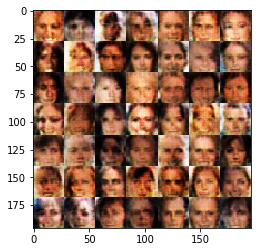

Epoch 1/1... batch 1250/6331... Discriminator Loss: 1.0329... Generator Loss: 0.8686


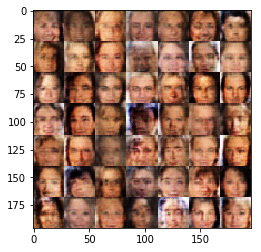

Epoch 1/1... batch 1300/6331... Discriminator Loss: 1.2762... Generator Loss: 0.5544


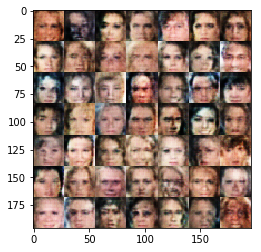

Epoch 1/1... batch 1350/6331... Discriminator Loss: 1.2978... Generator Loss: 0.5821


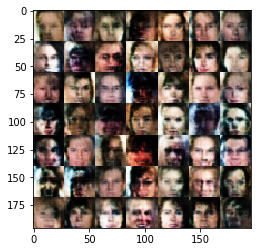

Epoch 1/1... batch 1400/6331... Discriminator Loss: 1.2726... Generator Loss: 0.6572


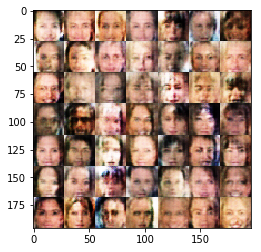

Epoch 1/1... batch 1450/6331... Discriminator Loss: 1.3670... Generator Loss: 0.4794


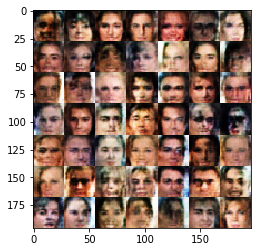

Epoch 1/1... batch 1500/6331... Discriminator Loss: 1.2941... Generator Loss: 0.7369


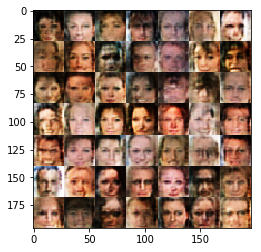

Epoch 1/1... batch 1550/6331... Discriminator Loss: 1.1676... Generator Loss: 0.8823


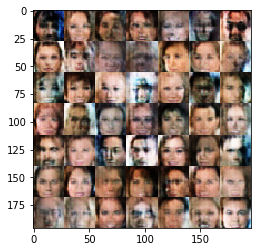

Epoch 1/1... batch 1600/6331... Discriminator Loss: 1.2761... Generator Loss: 0.5831


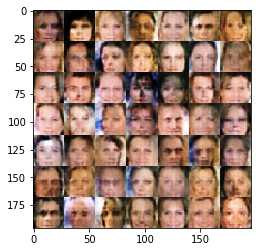

Epoch 1/1... batch 1650/6331... Discriminator Loss: 1.4892... Generator Loss: 0.4024


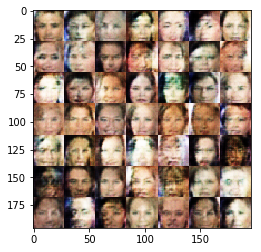

Epoch 1/1... batch 1700/6331... Discriminator Loss: 1.3513... Generator Loss: 0.4740


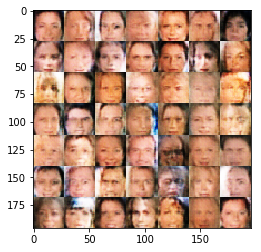

Epoch 1/1... batch 1750/6331... Discriminator Loss: 1.4405... Generator Loss: 0.5306


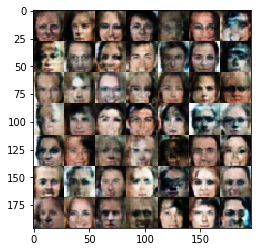

Epoch 1/1... batch 1800/6331... Discriminator Loss: 1.2682... Generator Loss: 0.6942


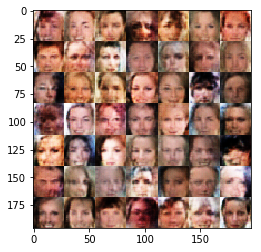

Epoch 1/1... batch 1850/6331... Discriminator Loss: 1.4193... Generator Loss: 0.5766


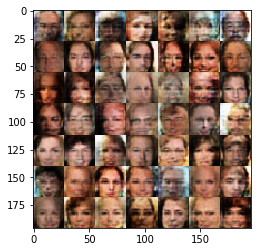

Epoch 1/1... batch 1900/6331... Discriminator Loss: 1.3330... Generator Loss: 0.6649


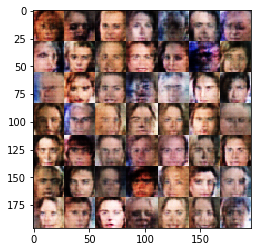

Epoch 1/1... batch 1950/6331... Discriminator Loss: 1.5251... Generator Loss: 0.6621


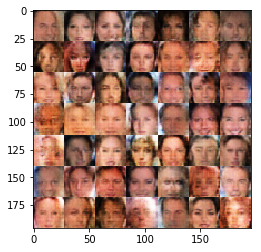

Epoch 1/1... batch 2000/6331... Discriminator Loss: 1.3904... Generator Loss: 0.5813


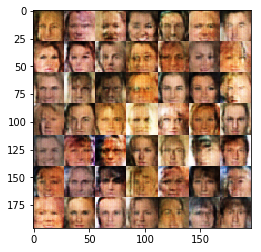

Epoch 1/1... batch 2050/6331... Discriminator Loss: 1.5734... Generator Loss: 0.4286


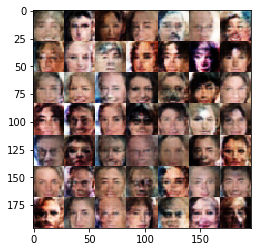

Epoch 1/1... batch 2100/6331... Discriminator Loss: 1.1086... Generator Loss: 0.9909


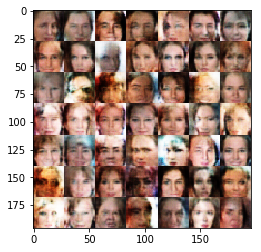

Epoch 1/1... batch 2150/6331... Discriminator Loss: 1.2791... Generator Loss: 0.5652


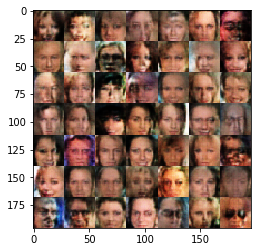

Epoch 1/1... batch 2200/6331... Discriminator Loss: 1.4210... Generator Loss: 0.6590


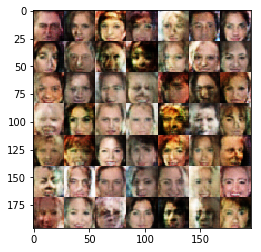

Epoch 1/1... batch 2250/6331... Discriminator Loss: 1.2450... Generator Loss: 0.6871


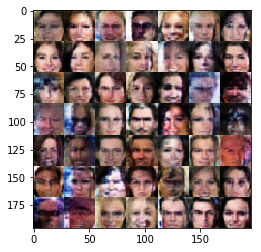

Epoch 1/1... batch 2300/6331... Discriminator Loss: 1.2639... Generator Loss: 0.7098


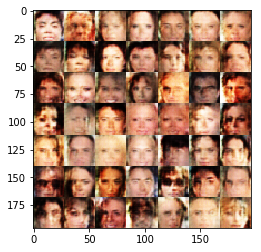

Epoch 1/1... batch 2350/6331... Discriminator Loss: 1.1297... Generator Loss: 0.6498


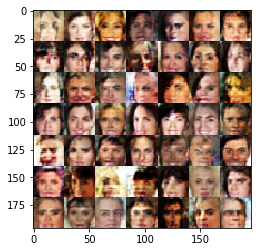

Epoch 1/1... batch 2400/6331... Discriminator Loss: 1.5383... Generator Loss: 0.3774


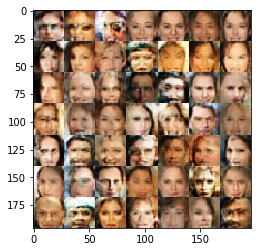

Epoch 1/1... batch 2450/6331... Discriminator Loss: 1.5091... Generator Loss: 0.8247


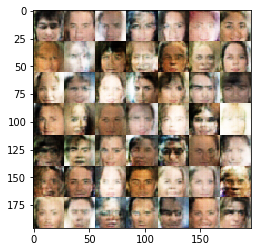

Epoch 1/1... batch 2500/6331... Discriminator Loss: 1.7440... Generator Loss: 0.3632


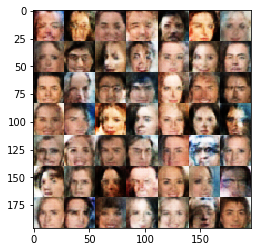

Epoch 1/1... batch 2550/6331... Discriminator Loss: 1.2563... Generator Loss: 0.6852


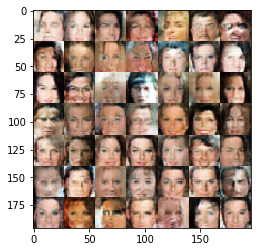

Epoch 1/1... batch 2600/6331... Discriminator Loss: 1.4761... Generator Loss: 0.5016


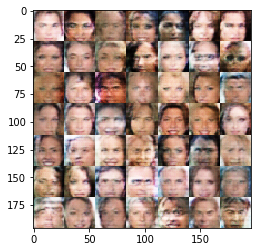

Epoch 1/1... batch 2650/6331... Discriminator Loss: 1.3788... Generator Loss: 0.6107


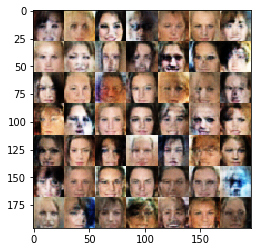

Epoch 1/1... batch 2700/6331... Discriminator Loss: 1.3089... Generator Loss: 0.5673


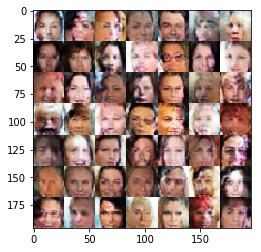

Epoch 1/1... batch 2750/6331... Discriminator Loss: 1.3700... Generator Loss: 0.7244


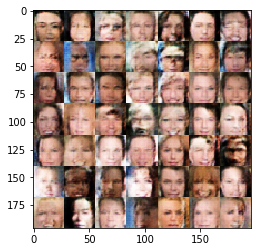

Epoch 1/1... batch 2800/6331... Discriminator Loss: 1.4683... Generator Loss: 0.4829


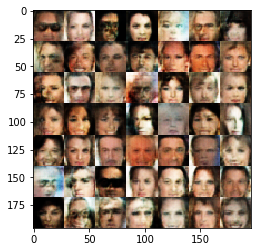

Epoch 1/1... batch 2850/6331... Discriminator Loss: 1.4896... Generator Loss: 0.4966


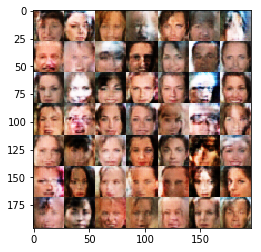

Epoch 1/1... batch 2900/6331... Discriminator Loss: 1.1245... Generator Loss: 0.6373


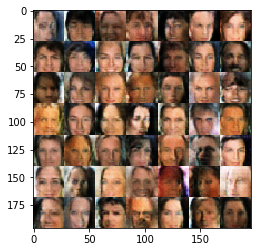

Epoch 1/1... batch 2950/6331... Discriminator Loss: 1.3022... Generator Loss: 0.6277


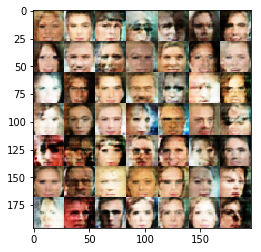

Epoch 1/1... batch 3000/6331... Discriminator Loss: 1.4087... Generator Loss: 0.4922


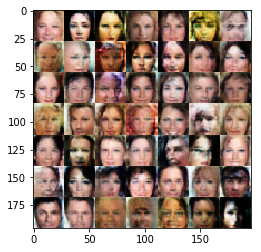

Epoch 1/1... batch 3050/6331... Discriminator Loss: 1.2186... Generator Loss: 0.6846


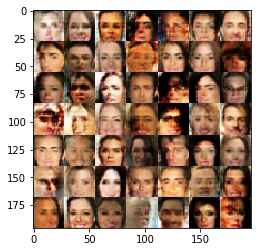

Epoch 1/1... batch 3100/6331... Discriminator Loss: 1.3198... Generator Loss: 0.5572


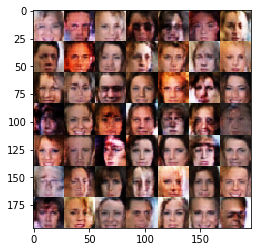

Epoch 1/1... batch 3150/6331... Discriminator Loss: 1.3273... Generator Loss: 0.5553


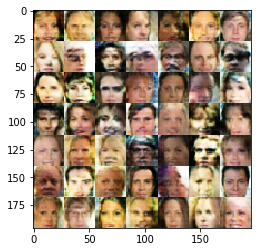

Epoch 1/1... batch 3200/6331... Discriminator Loss: 1.4383... Generator Loss: 0.8520


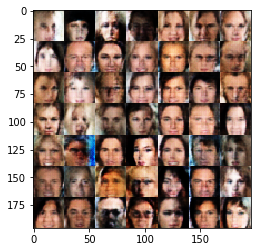

Epoch 1/1... batch 3250/6331... Discriminator Loss: 1.4796... Generator Loss: 0.3873


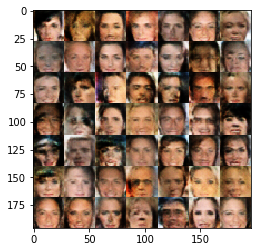

Epoch 1/1... batch 3300/6331... Discriminator Loss: 1.3706... Generator Loss: 0.8471


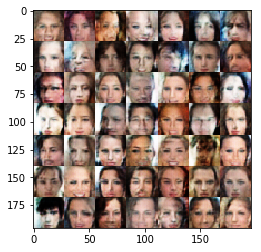

Epoch 1/1... batch 3350/6331... Discriminator Loss: 1.3908... Generator Loss: 0.4691


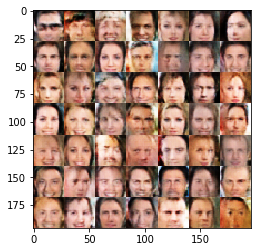

Epoch 1/1... batch 3400/6331... Discriminator Loss: 1.4429... Generator Loss: 0.4691


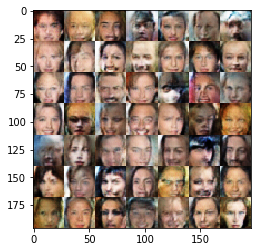

Epoch 1/1... batch 3450/6331... Discriminator Loss: 1.3780... Generator Loss: 0.6043


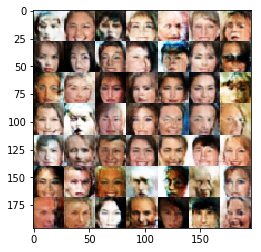

Epoch 1/1... batch 3500/6331... Discriminator Loss: 1.5865... Generator Loss: 0.3011


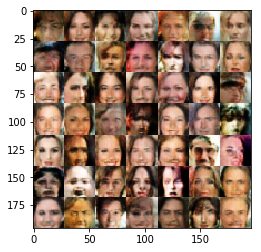

Epoch 1/1... batch 3550/6331... Discriminator Loss: 1.5559... Generator Loss: 0.3267


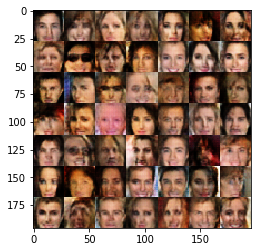

Epoch 1/1... batch 3600/6331... Discriminator Loss: 2.2129... Generator Loss: 0.2843


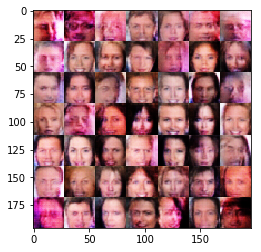

Epoch 1/1... batch 3650/6331... Discriminator Loss: 1.4191... Generator Loss: 0.5907


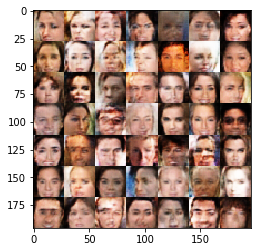

Epoch 1/1... batch 3700/6331... Discriminator Loss: 0.9329... Generator Loss: 0.8262


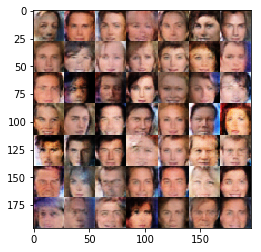

Epoch 1/1... batch 3750/6331... Discriminator Loss: 1.0708... Generator Loss: 0.8752


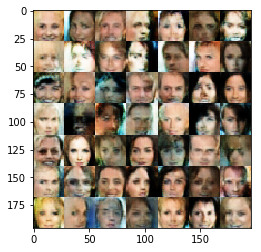

Epoch 1/1... batch 3800/6331... Discriminator Loss: 0.9460... Generator Loss: 0.7675


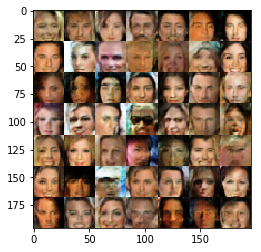

Epoch 1/1... batch 3850/6331... Discriminator Loss: 1.2042... Generator Loss: 0.6954


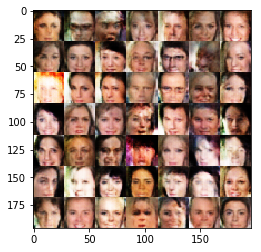

Epoch 1/1... batch 3900/6331... Discriminator Loss: 1.2244... Generator Loss: 1.3596


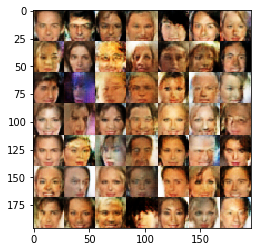

Epoch 1/1... batch 3950/6331... Discriminator Loss: 1.0059... Generator Loss: 3.4862


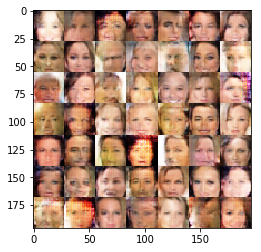

Epoch 1/1... batch 4000/6331... Discriminator Loss: 1.4426... Generator Loss: 0.3829


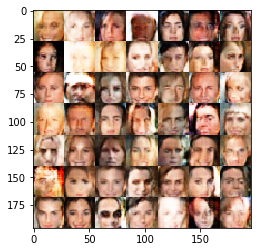

Epoch 1/1... batch 4050/6331... Discriminator Loss: 1.9246... Generator Loss: 0.2046


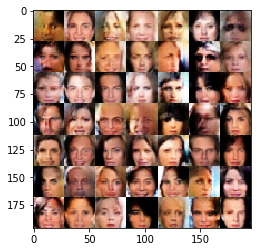

Epoch 1/1... batch 4100/6331... Discriminator Loss: 1.7922... Generator Loss: 0.2473


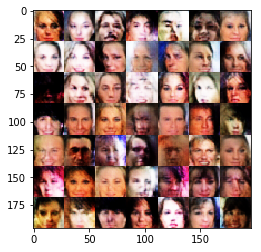

Epoch 1/1... batch 4150/6331... Discriminator Loss: 1.1529... Generator Loss: 1.4864


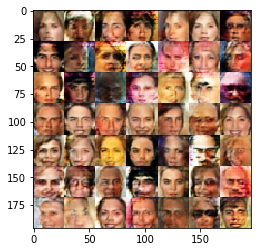

Epoch 1/1... batch 4200/6331... Discriminator Loss: 2.0152... Generator Loss: 0.1964


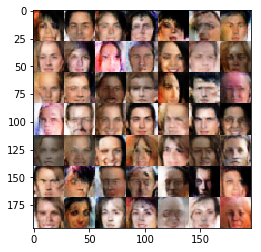

Epoch 1/1... batch 4250/6331... Discriminator Loss: 1.2530... Generator Loss: 0.4390


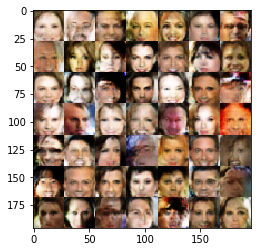

Epoch 1/1... batch 4300/6331... Discriminator Loss: 1.3446... Generator Loss: 0.4626


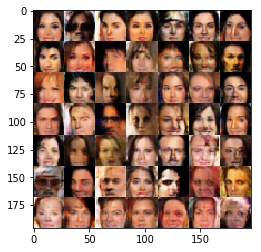

Epoch 1/1... batch 4350/6331... Discriminator Loss: 1.5620... Generator Loss: 0.3119


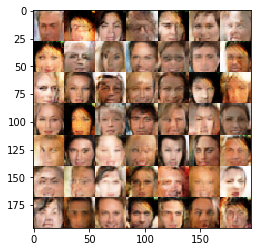

Epoch 1/1... batch 4400/6331... Discriminator Loss: 0.8456... Generator Loss: 1.5406


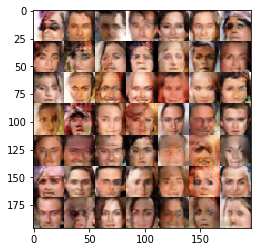

Epoch 1/1... batch 4450/6331... Discriminator Loss: 1.2512... Generator Loss: 0.7172


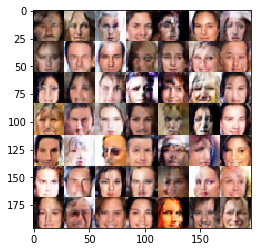

Epoch 1/1... batch 4500/6331... Discriminator Loss: 0.5938... Generator Loss: 1.7533


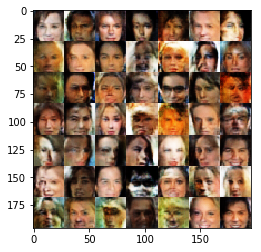

Epoch 1/1... batch 4550/6331... Discriminator Loss: 0.8157... Generator Loss: 1.3573


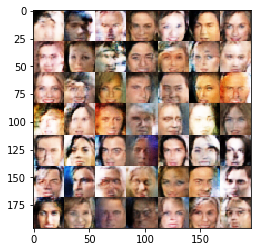

Epoch 1/1... batch 4600/6331... Discriminator Loss: 1.3526... Generator Loss: 0.5365


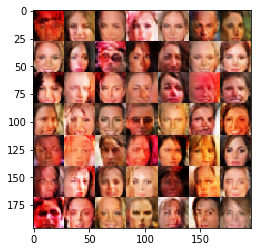

Epoch 1/1... batch 4650/6331... Discriminator Loss: 0.6717... Generator Loss: 1.2724


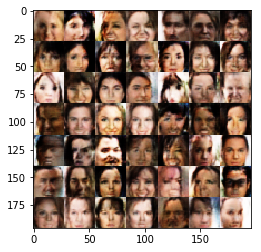

Epoch 1/1... batch 4700/6331... Discriminator Loss: 0.8181... Generator Loss: 1.5916


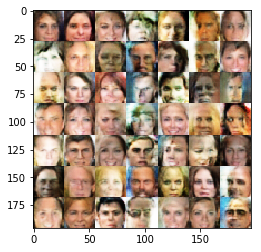

Epoch 1/1... batch 4750/6331... Discriminator Loss: 1.0709... Generator Loss: 0.6825


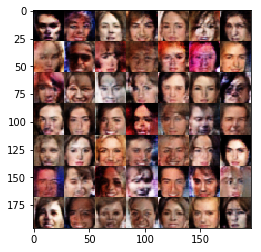

Epoch 1/1... batch 4800/6331... Discriminator Loss: 1.5647... Generator Loss: 0.3363


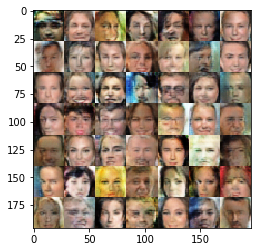

Epoch 1/1... batch 4850/6331... Discriminator Loss: 0.8845... Generator Loss: 1.2221


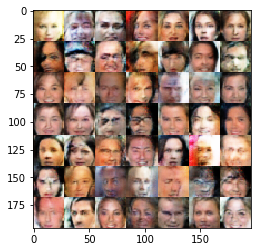

Epoch 1/1... batch 4900/6331... Discriminator Loss: 1.8479... Generator Loss: 0.2277


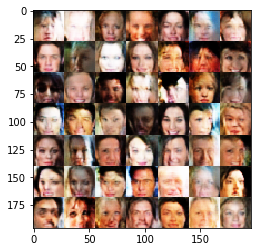

Epoch 1/1... batch 4950/6331... Discriminator Loss: 0.8436... Generator Loss: 2.0930


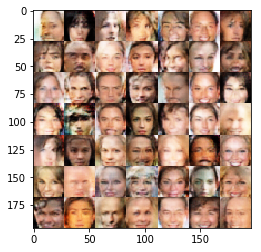

Epoch 1/1... batch 5000/6331... Discriminator Loss: 1.5545... Generator Loss: 0.3520


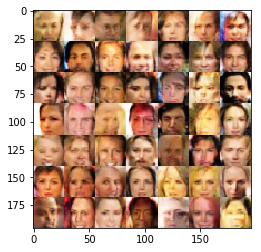

Epoch 1/1... batch 5050/6331... Discriminator Loss: 1.2437... Generator Loss: 1.3967


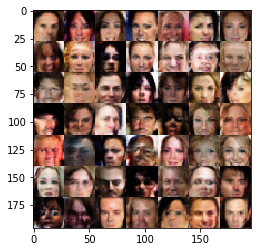

Epoch 1/1... batch 5100/6331... Discriminator Loss: 1.3122... Generator Loss: 0.4775


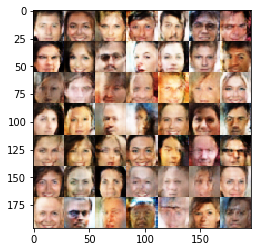

Epoch 1/1... batch 5150/6331... Discriminator Loss: 0.5955... Generator Loss: 1.5426


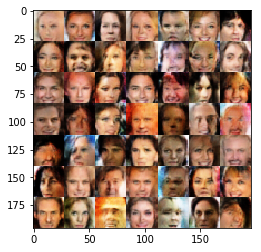

Epoch 1/1... batch 5200/6331... Discriminator Loss: 1.1437... Generator Loss: 0.6518


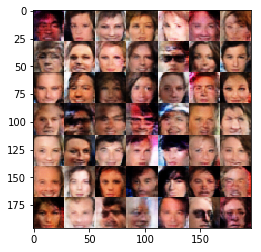

Epoch 1/1... batch 5250/6331... Discriminator Loss: 0.8238... Generator Loss: 2.5927


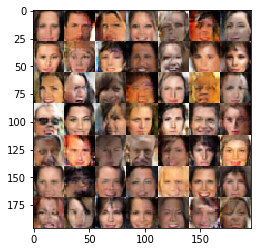

Epoch 1/1... batch 5300/6331... Discriminator Loss: 0.7612... Generator Loss: 1.3798


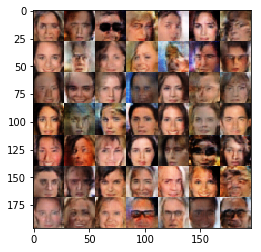

Epoch 1/1... batch 5350/6331... Discriminator Loss: 0.8308... Generator Loss: 1.1053


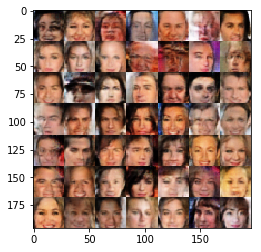

Epoch 1/1... batch 5400/6331... Discriminator Loss: 0.5153... Generator Loss: 2.0990


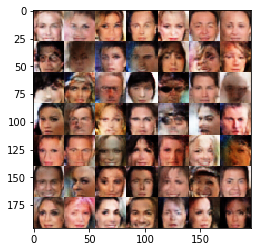

Epoch 1/1... batch 5450/6331... Discriminator Loss: 1.2793... Generator Loss: 0.8494


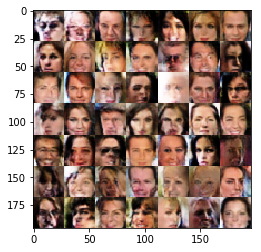

Epoch 1/1... batch 5500/6331... Discriminator Loss: 1.2516... Generator Loss: 0.4649


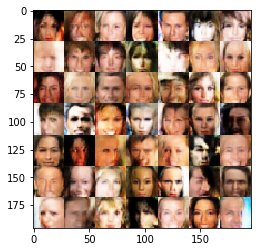

Epoch 1/1... batch 5550/6331... Discriminator Loss: 0.9024... Generator Loss: 1.1048


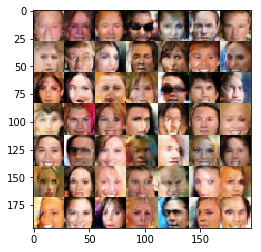

Epoch 1/1... batch 5600/6331... Discriminator Loss: 1.8894... Generator Loss: 0.2198


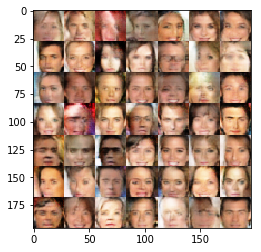

Epoch 1/1... batch 5650/6331... Discriminator Loss: 1.2456... Generator Loss: 0.7308


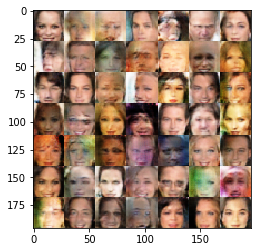

Epoch 1/1... batch 5700/6331... Discriminator Loss: 1.3699... Generator Loss: 0.4344


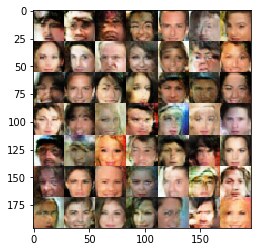

Epoch 1/1... batch 5750/6331... Discriminator Loss: 0.7878... Generator Loss: 1.5963


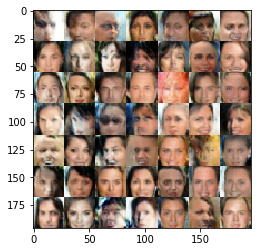

Epoch 1/1... batch 5800/6331... Discriminator Loss: 1.1174... Generator Loss: 0.8310


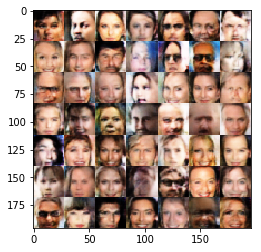

Epoch 1/1... batch 5850/6331... Discriminator Loss: 1.2434... Generator Loss: 0.6373


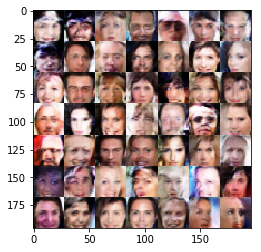

Epoch 1/1... batch 5900/6331... Discriminator Loss: 1.8778... Generator Loss: 1.8029


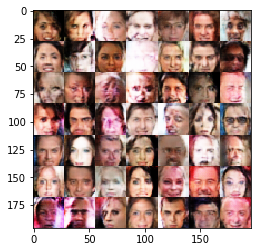

Epoch 1/1... batch 5950/6331... Discriminator Loss: 0.9663... Generator Loss: 2.8765


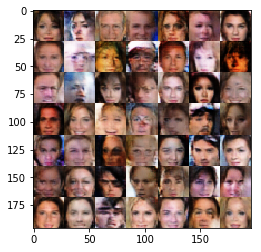

Epoch 1/1... batch 6000/6331... Discriminator Loss: 0.9279... Generator Loss: 2.8897


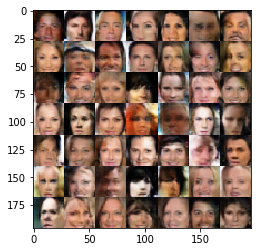

Epoch 1/1... batch 6050/6331... Discriminator Loss: 1.1343... Generator Loss: 0.6558


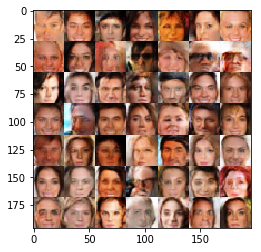

Epoch 1/1... batch 6100/6331... Discriminator Loss: 1.3275... Generator Loss: 0.7167


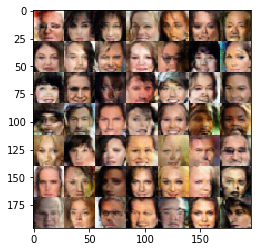

Epoch 1/1... batch 6150/6331... Discriminator Loss: 1.1312... Generator Loss: 0.5697


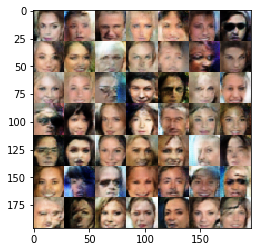

Epoch 1/1... batch 6200/6331... Discriminator Loss: 1.0291... Generator Loss: 0.8329


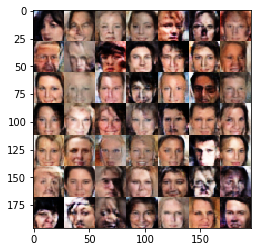

Epoch 1/1... batch 6250/6331... Discriminator Loss: 1.0740... Generator Loss: 0.6248


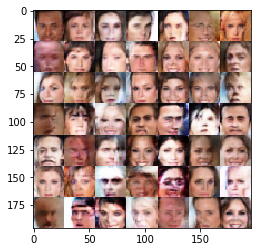

Epoch 1/1... batch 6300/6331... Discriminator Loss: 0.4954... Generator Loss: 2.1964


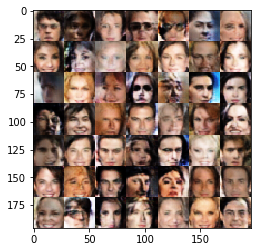

FINAL RESULT Generator Loss: 0.6099


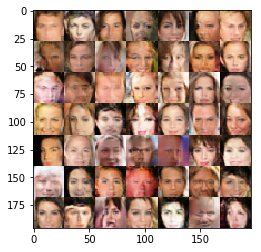

In [76]:
batch_size = 32
z_dim = 128
learning_rate = 0.0002
beta1 = 0.5
dropout_rate = 0.2

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode, dropout_rate)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.